<a href="https://colab.research.google.com/github/qwymierne/Bachelors/blob/master/DL_project2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data import and preprocessing

In [1]:
! wget http://www.mimuw.edu.pl/~ciebie/cityscapes.tgz

--2019-05-14 16:34:24--  http://www.mimuw.edu.pl/~ciebie/cityscapes.tgz
Resolving www.mimuw.edu.pl (www.mimuw.edu.pl)... 193.0.96.14
Connecting to www.mimuw.edu.pl (www.mimuw.edu.pl)|193.0.96.14|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://www.mimuw.edu.pl/~ciebie/cityscapes.tgz [following]
--2019-05-14 16:34:24--  https://www.mimuw.edu.pl/~ciebie/cityscapes.tgz
Connecting to www.mimuw.edu.pl (www.mimuw.edu.pl)|193.0.96.14|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 310275605 (296M) [application/x-gzip]
Saving to: ‘cityscapes.tgz’

cityscapes.tgz      100%[===================>] 295.90M  32.1MB/s    in 11s     

2019-05-14 16:34:36 (26.2 MB/s) - ‘cityscapes.tgz’ saved [310275605/310275605]



In [0]:
import os
from itertools import product
import tarfile
import random
import shutil

import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable

from skimage import io
from torch.utils.data import Dataset, DataLoader, ConcatDataset
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

device = torch.device("cuda")

### Net constants

In [0]:
VALID_SET_SIZE = 0.15
IMAGE_H = 256
IMAGE_W = 256
CHANNELS = 3
LEARNING_RATE = 0.0005

FIRST_FILTERS = 64
SECOND_FILTERS = 2 * FIRST_FILTERS
THIRD_FILTERS = 2 * SECOND_FILTERS
FOURTH_FILTERS = 2 * THIRD_FILTERS
FIFTH_FILTERS = 2 * FOURTH_FILTERS

DECREASE_FACTOR = 2

CLUSTERS = np.array(
    [[116, 17, 36],
     [152, 43,150],
     [106,141, 34],
     [ 69, 69, 69],
     [  2,  1,  3],
     [127, 63,126],
     [222, 52,211],
     [  2,  1,140],
     [ 93,117,119],
     [180,228,182],
     [213,202, 43],
     [ 79,  2, 80],
     [188,151,155],
     [  9,  5, 91],
     [106, 75, 13],
     [215, 20, 53],
     [110,134, 62],
     [  8, 68, 98],
     [244,171,170],
     [171, 43, 74],
     [104, 96,155],
     [ 72,130,177],
     [242, 35,231],
     [147,149,149],
     [ 35, 25, 34],
     [155,247,151],
     [ 85, 68, 99],
     [ 71, 81, 43],
     [195, 64,182],
     [146,133, 92]]
)

In [0]:
tar = tarfile.open('cityscapes.tgz', "r:gz")
tar.extractall()
tar.close()

In [0]:
files = []
for file in os.listdir('cityscapes'):
  if file.endswith('.png'):
    files.append(file)
files = sorted(files)
random.seed(666)
random.shuffle(files)
train_set = files[:int(len(files) * (1 - VALID_SET_SIZE))]
valid_set = files[int(len(files) * (1 - VALID_SET_SIZE)):]

if not os.path.exists('train'):
  os.makedirs('train')
if not os.path.exists('valid'):
  os.makedirs('valid')

for file in train_set:
  shutil.copyfile(os.path.join('cityscapes', file), os.path.join('train', file))

for file in valid_set:
  shutil.copyfile(os.path.join('cityscapes', file), os.path.join('valid', file))

# Image loading and dataset creation

In [0]:
class ImageToClusters:

    def __init__(self, pixel_map):
        self.pixel_map = pixel_map

    def __call__(self, image):

        h, w = image.shape[:2]
        
        mapped_image = np.zeros([h, w, len(self.pixel_map)])
        for cluster, pixel in enumerate(self.pixel_map):
          mapped_image[:, :, cluster] = (image==pixel).all(2)

        return mapped_image
 

class ClustersToImage:

    def __init__(self, pixel_map):
        self.pixel_map = pixel_map

    def __call__(self, clustred_image):
      maxed_channels = torch.zeros_like(clustred_image)
      positions = product(range(clustred_image.shape[1]), range((clustred_image.shape[2])))
      maxes = [pos for pos_list in clustred_image.max(0)[1] for pos in pos_list]
      to_change = [(x[0], x[1][0], x[1][1]) for x in zip(maxes, positions)]
      maxed_channels[list(zip(*to_change))] = 1
      return np.dot(maxed_channels.permute(1, 2, 0), self.pixel_map).astype('int32')
   

class HorizontalFlip:

    def __call__(self, image):
      if isinstance(image, torch.Tensor):
        return torch.Tensor(np.fliplr(image.cpu().permute(1, 2, 0)).copy()).permute(2, 0, 1).to(device)
      else:
        return np.fliplr(image).copy()

In [0]:
class CityscapesDataset(Dataset):
    """Cityscapes dataset."""

    def __init__(self, root_dir, transform_input=None, transform_output=None):

        self.root_dir = root_dir
        self.images_names = os.listdir(self.root_dir)
        self.transform_input = transform_input
        self.transform_output = transform_output

    def __len__(self):
        return len(self.images_names)

    def __getitem__(self, idx):
        img_name = os.path.join(self.root_dir, self.images_names[idx])
        image = io.imread(img_name)
        image_in = image[:, :IMAGE_W, :]
        image_out = image[:, IMAGE_W:, :]

        if self.transform_input:
            image_in = self.transform_input(image_in)
        
        if self.transform_output:
            image_out = self.transform_output(image_out)

        return image_in, image_out


In [0]:
class ValidCityscapesDataset(Dataset):
    def __init__(self, images, transformers):
        flipped = [HorizontalFlip()(image) for image in images]
        self.images = [im for sublist in zip(images, flipped) for im in sublist]
        self.transformers = transformers
        
    def __len__(self):
        return len(self.images)
      
    def __getitem__(self, idx):
        image = self.images[idx]

        if self.transformers:
            image = self.transformers(image)
        
        return image

In [0]:
transform_input = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0., 0., 0.), (1., 1., 1.))]
)

transform_input_flips = transforms.Compose(
    [HorizontalFlip(),
     transforms.ToTensor(),
     transforms.Normalize((0., 0., 0.), (1., 1., 1.))]
)

transform_output = transforms.Compose(
    [ImageToClusters(CLUSTERS),
     transforms.ToTensor()]
)

transform_output_flips = transforms.Compose(
    [HorizontalFlip(),
     ImageToClusters(CLUSTERS),
     transforms.ToTensor()]
)


# Net definition

In [0]:
class UNetStageConv(nn.Module):
    
    def __init__(self, input_channels, output_channels):
        super(UNetStageConv, self).__init__()
     
        self.conv1 = nn.Conv2d(input_channels, output_channels, 3, padding=1)
        self.bn1 = nn.BatchNorm2d(output_channels)
        self.conv2 = nn.Conv2d(output_channels, output_channels, 3, padding=1)
        self.bn2 = nn.BatchNorm2d(output_channels)

    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = F.relu(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = F.relu(x)
        return x

In [0]:
class UNet(nn.Module):

    def __init__(self):
        super(UNet, self).__init__()
        self.stage_contracting_1 = UNetStageConv(CHANNELS, FIRST_FILTERS)
        self.stage_contracting_2 = UNetStageConv(FIRST_FILTERS, SECOND_FILTERS)
        self.stage_contracting_3 = UNetStageConv(SECOND_FILTERS, THIRD_FILTERS)
        self.stage_contracting_4 = UNetStageConv(THIRD_FILTERS, FOURTH_FILTERS)
        
        self.bottom_stage = UNetStageConv(FOURTH_FILTERS, FIFTH_FILTERS)
        
        self.conv_trans_1 = nn.ConvTranspose2d(FIFTH_FILTERS, FOURTH_FILTERS,
                                               2, stride=DECREASE_FACTOR)
        self.stage_expansive_4 = UNetStageConv(FIFTH_FILTERS, FOURTH_FILTERS)
        
        self.conv_trans_2 = nn.ConvTranspose2d(FOURTH_FILTERS, THIRD_FILTERS, 2,
                                               stride=DECREASE_FACTOR)
        self.stage_expansive_3 = UNetStageConv(FOURTH_FILTERS, THIRD_FILTERS)
        
        self.conv_trans_3 = nn.ConvTranspose2d(THIRD_FILTERS, SECOND_FILTERS, 2,
                                               stride=DECREASE_FACTOR)
        self.stage_expansive_2 = UNetStageConv(THIRD_FILTERS, SECOND_FILTERS)
        
        self.conv_trans_4 = nn.ConvTranspose2d(SECOND_FILTERS, FIRST_FILTERS, 2,
                                               stride=DECREASE_FACTOR)
        self.stage_expansive_1 = UNetStageConv(SECOND_FILTERS, FIRST_FILTERS)
        
        self.final_conv = nn.Conv2d(FIRST_FILTERS, len(CLUSTERS), 1)
        

    def forward(self, x):
        sc1 = self.stage_contracting_1(x)
        
        sc2 = nn.MaxPool2d(DECREASE_FACTOR, DECREASE_FACTOR)(sc1)
        sc2 = self.stage_contracting_2(sc2)
        
        sc3 = nn.MaxPool2d(DECREASE_FACTOR, DECREASE_FACTOR)(sc2)
        sc3 = self.stage_contracting_3(sc3)
        
        sc4 = nn.MaxPool2d(DECREASE_FACTOR, DECREASE_FACTOR)(sc3)
        sc4 = self.stage_contracting_4(sc4)
        
        bs = nn.MaxPool2d(DECREASE_FACTOR, DECREASE_FACTOR)(sc4)
        bs = self.bottom_stage(bs)
        
        se4 = self.conv_trans_1(bs)
        
        se3 = torch.cat((sc4, se4), 1)
        se3 = self.stage_expansive_4(se3)
        se3 = self.conv_trans_2(se3)
        
        se2 = torch.cat((sc3, se3), 1)
        se2 = self.stage_expansive_3(se2)
        se2 = self.conv_trans_3(se2)
        
        se1 = torch.cat((sc2, se2), 1)
        se1 = self.stage_expansive_2(se1)
        se1 = self.conv_trans_4(se1)
        
        y = torch.cat((sc1, se1), 1)
        y = self.stage_expansive_1(y)
        y = self.final_conv(y)
        
        res = nn.Softmax2d()(y)
        
        return res

# Training and testing functions

In [0]:
def plot_validation(img1, img2, img3, title):
    f, axarr = plt.subplots(1, 3)
    axarr[0].imshow(img1)
    axarr[1].imshow(img2)
    axarr[2].imshow(img3)
    axarr[2].set_title(title)
    plt.show()


In [0]:
def validate_images(root_dir, for_eval_count, model, show_results=True):

    images_raw = [io.imread(os.path.join(root_dir, im_name))
                  for im_name in os.listdir(root_dir)[:for_eval_count]]
    splitted_images = [(im[:, :IMAGE_W, :], im[:, IMAGE_W:, :]) for im in images_raw]
    inputs, outputs = list(zip(*splitted_images))

    valid_set = ValidCityscapesDataset(inputs, transform_input)

    valid_loader= torch.utils.data.DataLoader(
            valid_set,
            batch_size=2,
            num_workers=0,
            shuffle=False
        )

    model.eval()
    scores = []
    
    with torch.no_grad():
        for i, images in enumerate(valid_loader):
            images = images.to(device)

            output_org, output_flipped = model(images)
            mean_output = (output_org + HorizontalFlip()(output_flipped)) / 2
            mean_output_image = ClustersToImage(CLUSTERS)(mean_output.cpu().detach())
            
            score = np.sum(outputs[i] == mean_output_image) / outputs[i].size
            scores.append(score)

            if show_results:
                plot_validation(images[0].permute(1, 2, 0).cpu().detach(),
                                outputs[i],
                                mean_output_image,
                                f"Score: {score}")
    return np.array(scores).mean()

In [0]:
def train_model(model, criterion, optimizer, num_of_epochs, train_loader, device):

    for epoch in range(num_of_epochs):  # loop over the dataset multiple times
        model.train()
        running_loss = 0.0
        for i, data in enumerate(train_loader):
            # get the inputs
            
            data_in, data_out = data
            data_in, data_out = data_in.to(device), data_out.to(device)

            # zero the parameter gradients
            optimizer.zero_grad()

            # forward + backward + optimize
            outputs = model(data_in)
            outputs = outputs.to(torch.double)
            
            loss = criterion(outputs, data_out)
            loss.backward()
            optimizer.step()

            # print statistics
            running_loss += loss.item()
            if i % 100 == 99:  # print every 100 mini-batches
                print(f'[{epoch}, {i + 1}] loss: {running_loss / 100}')
                running_loss = 0.0
        
        print(f"Score on partial valid: {validate_images('valid', 100, model, False)}")
        validate_images('valid', 10, model, True)

    print('Finished Training')

### Training

UNet(
  (stage_contracting_1): UNetStageConv(
    (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (stage_contracting_2): UNetStageConv(
    (conv1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (stage_contracting_3): UNetStageConv(
    (conv1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv

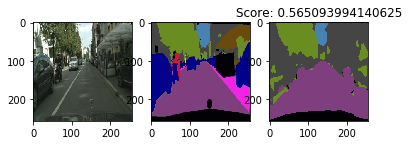

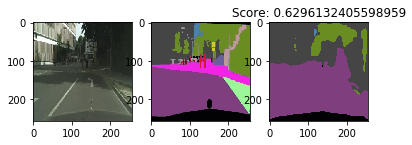

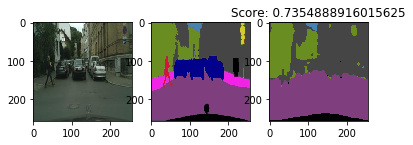

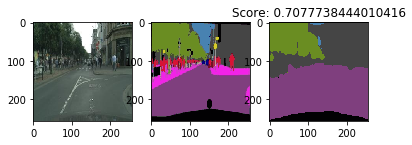

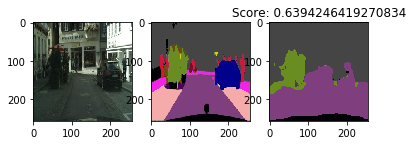

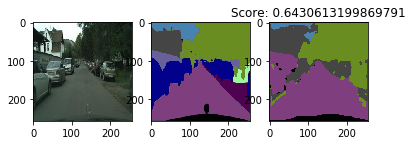

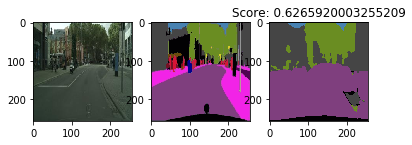

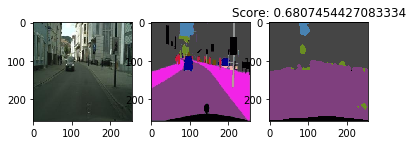

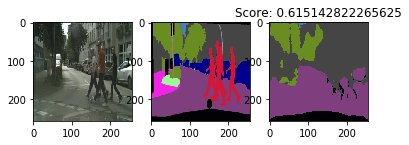

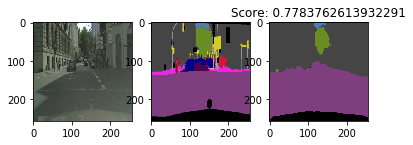

[1, 100] loss: 0.6912713803543834
[1, 200] loss: 0.6899352113038529
[1, 300] loss: 0.6895425436064896
Score on partial valid: 0.7409272257486978


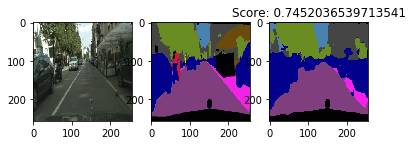

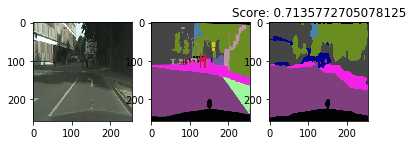

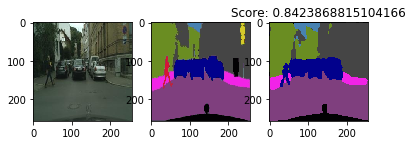

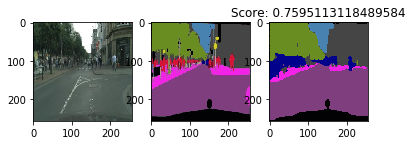

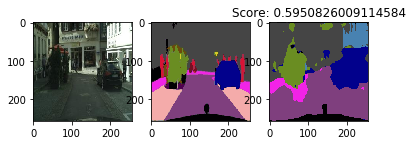

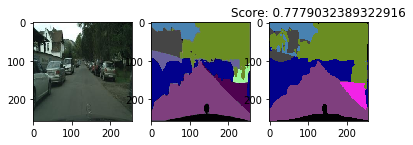

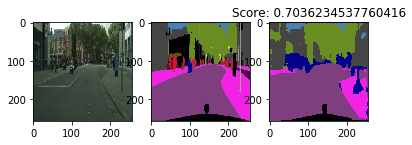

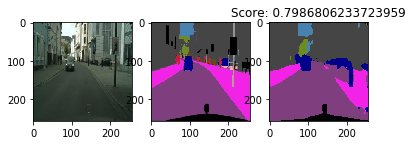

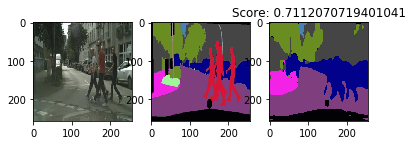

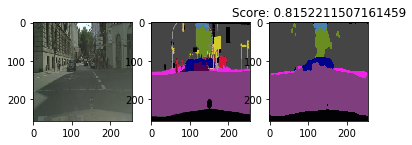

[2, 100] loss: 0.6888695234788645
[2, 200] loss: 0.6886007932459758
[2, 300] loss: 0.6883495900017909
Score on partial valid: 0.7735820007324218


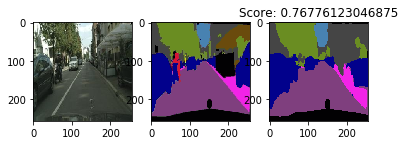

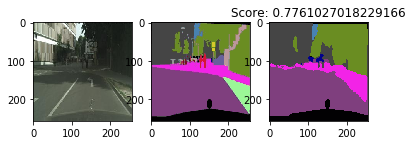

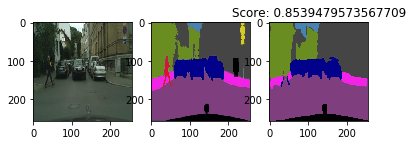

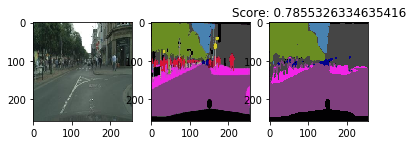

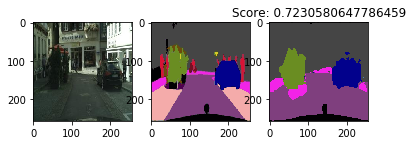

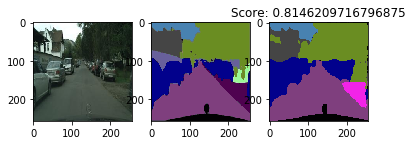

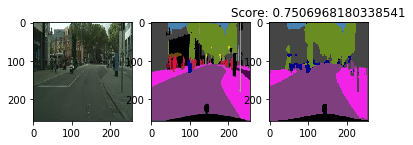

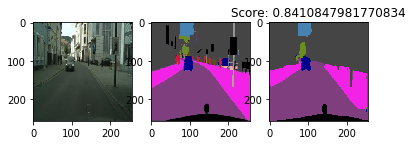

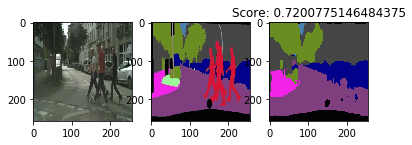

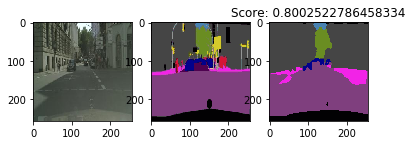

Finished Training


In [16]:
train_set = CityscapesDataset('train',
                              transform_input=transform_input,
                              transform_output=transform_output)

train_set_flips = CityscapesDataset('train',
                                    transform_input=transform_input_flips,
                                    transform_output=transform_output_flips)

train_loader = torch.utils.data.DataLoader(
        ConcatDataset([train_set, train_set_flips]),
        batch_size=16,
        num_workers=0,
        shuffle=True
    )

net = UNet()
net.to(device)
print(net)

train_model(
    net,
    criterion=nn.BCEWithLogitsLoss(),
    optimizer=optim.Adam(net.parameters(), lr=LEARNING_RATE),
    num_of_epochs=3,
    train_loader=train_loader,
    device=device
)

### Evaluation

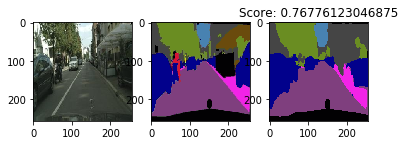

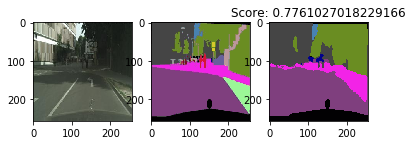

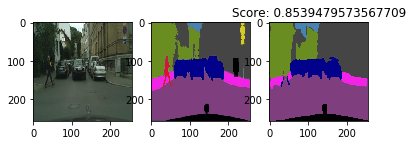

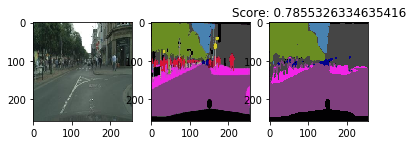

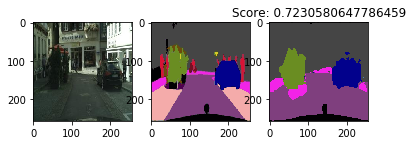

...

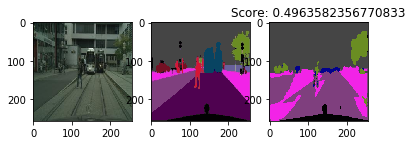

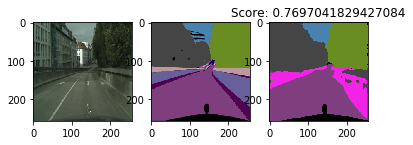

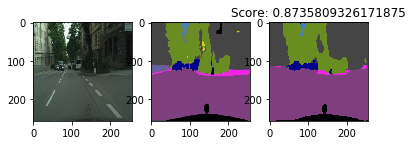

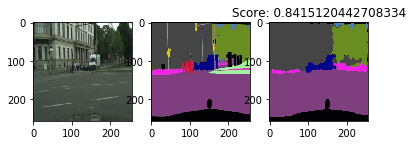

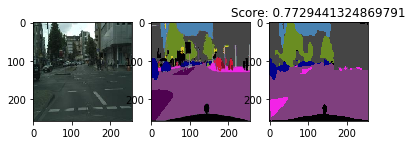

0.7728254009498211

In [17]:
validate_images('valid', -1, net, True)